In [9]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from textblob import TextBlob
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk

In [10]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\hp\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [11]:
save_path = r"C:\Users\hp\Desktop\immuniwatch_plots"
os.makedirs(save_path, exist_ok=True)

In [12]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [13]:
url = "https://huggingface.co/datasets/AHFIDAILabs/merged_vaccines/resolve/main/clean_scraped_posts.csv"

df = pd.read_csv(url, low_memory=False)

In [14]:
df.head(2)

,Tweet_Text,Reply_Count,Retweet_Count,Like_Count,View_Count,Language,Source,Username,Location,year,month,day,hour,minute,weekday,Post_ID,ID_Source
0,The HPV vaccine is a critical step in preventi...,1.0,0.0,2.0,81.0,English,Twitter,VaccineNet_NG,"Lagos, Nigeria",2024,7,1,17,58,Monday,"=""1807821100576895401""",Platform_ID
1,"New month, new experiences, new opportunities,...",0.0,0.0,2.0,50.0,English,Twitter,VaccineNet_NG,Abuja. Nigeria.,2024,7,1,15,2,Monday,"=""1807776904805580853""",Platform_ID


In [15]:
df1 = df.copy()

In [16]:
df.shape

(45005, 17)

In [17]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Reply_Count,45005.0,0.469592,8.272584,0.0,0.0,0.0,0.0,725.0
Retweet_Count,45005.0,1.590845,34.184906,0.0,0.0,0.0,0.0,2507.0
Like_Count,45005.0,10.274370,165.675794,0.0,1.0,1.0,1.0,9249.0
View_Count,45005.0,6464.449706,261353.025591,0.0,81.0,81.0,81.0,23410141.0
year,45005.0,2023.826508,1.495478,2008.0,2024.0,2024.0,2025.0,2025.0
month,45005.0,7.693834,3.381336,1.0,4.0,8.0,11.0,12.0
day,45005.0,13.709921,9.681631,1.0,4.0,12.0,22.0,31.0
hour,45005.0,12.833374,6.468251,0.0,8.0,13.0,18.0,23.0
minute,45005.0,29.865615,17.057448,0.0,16.0,30.0,44.0,59.0


In [18]:
df['Username'].unique

<bound method Series.unique of 0                                            VaccineNet_NG
1                                            VaccineNet_NG
2                                            VaccineNet_NG
3                                            VaccineNet_NG
4                                            VaccineNet_NG
5                                            VaccineNet_NG
6                                            VaccineNet_NG
7                                            VaccineNet_NG
8                                            VaccineNet_NG
9                                            VaccineNet_NG
10                                           VaccineNet_NG
11                                           VaccineNet_NG
12                                           VaccineNet_NG
13                                           VaccineNet_NG
14                                           VaccineNet_NG
15                                           VaccineNet_NG
16                       

In [19]:
df['Username'].value_counts()

Username
Unknown_User                                                                 718
VaccineNet_NG                                                                601
Mss_Deeynah                                                                   64
__luzid__                                                                     62
VigilantFox                                                                   54
Xx2Fudixt                                                                     42
YarKafanchan                                                                  36
ValerieAnne1970                                                               36
DrGeeONE                                                                      34
Elizabeth Wyntjes                                                             30
aproko_doctor                                                                 30
enodamade                                                                     29
itzclarkson        

In [20]:
df1.tail(2)

,Tweet_Text,Reply_Count,Retweet_Count,Like_Count,View_Count,Language,Source,Username,Location,year,month,day,hour,minute,weekday,Post_ID,ID_Source
45003,"['Skip to content Skip to content', ""St Ives |...",0.0,0.0,1.0,81.0,Igbo,Blogs,Unknown_User,Nigeria,2025,2,22,4,8,Saturday,SYN_bb20a8aa1907ea16,Synthetic_ID
45004,['Danjuma Shehu Ibrahim writes on the urgent n...,0.0,0.0,1.0,81.0,Igbo,Blogs,Unknown_User,Land Down Under,2021,2,2,9,6,Tuesday,SYN_96eb5de6fbd69508,Synthetic_ID


In [21]:
df.dtypes

Tweet_Text        object
Reply_Count      float64
Retweet_Count    float64
Like_Count       float64
View_Count       float64
Language          object
Source            object
Username          object
Location          object
year               int64
month              int64
day                int64
hour               int64
minute             int64
weekday           object
Post_ID           object
ID_Source         object
dtype: object

In [22]:
cat_columns = df.describe(include=["object", "category"]).columns
cat_columns

Index(['Tweet_Text', 'Language', 'Source', 'Username', 'Location', 'weekday',
       'Post_ID', 'ID_Source'],
      dtype='object')

In [23]:
df['year'].value_counts()

year
2024    18303
2025    16582
2021     5317
2023     3818
2022      491
2019      236
2015       40
2013       34
2011       34
2020       31
2012       25
2016       23
2014       18
2018       18
2017       16
2010       11
2009        7
2008        1
Name: count, dtype: int64

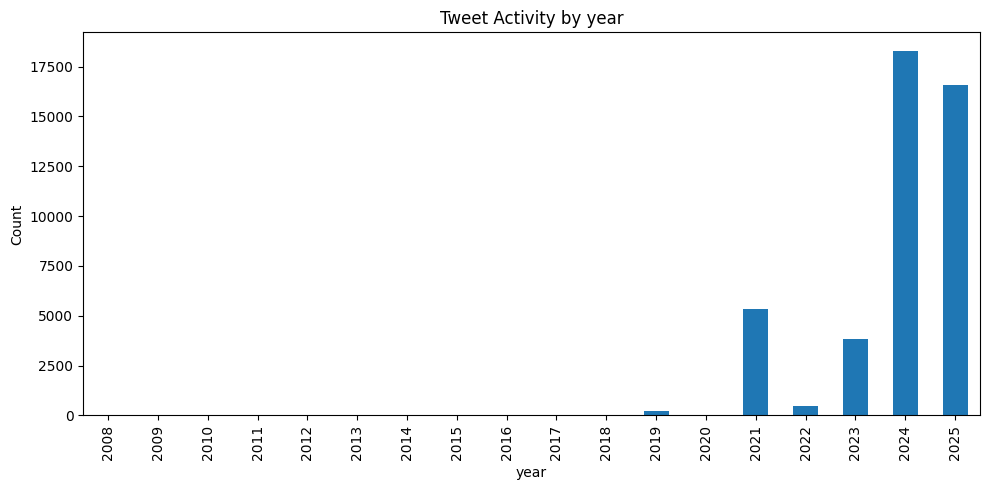

In [24]:
fig = plt.figure(figsize=(10,5))
df["year"].value_counts().sort_index().plot(kind="bar")
plt.title("Tweet Activity by year")
plt.xlabel("year")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

In [25]:
fig.savefig(os.path.join(save_path, "year_activity.png"))
plt.close()

In [26]:
month_map = {1:'January', 2:'February', 3:'March', 4:'April', 5:'May', 6:'June',
             7:'July', 8:'August', 9:'September', 10:'October', 11:'November', 12:'December'}

df['month_name'] = df['month'].map(month_map)

month_order = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']
month_counts = df['month_name'].value_counts().reindex(month_order)

C:\Users\hp\AppData\Local\Temp\ipykernel_7988\3397670308.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=month_counts.index, y=month_counts.values, palette='cubehelix')


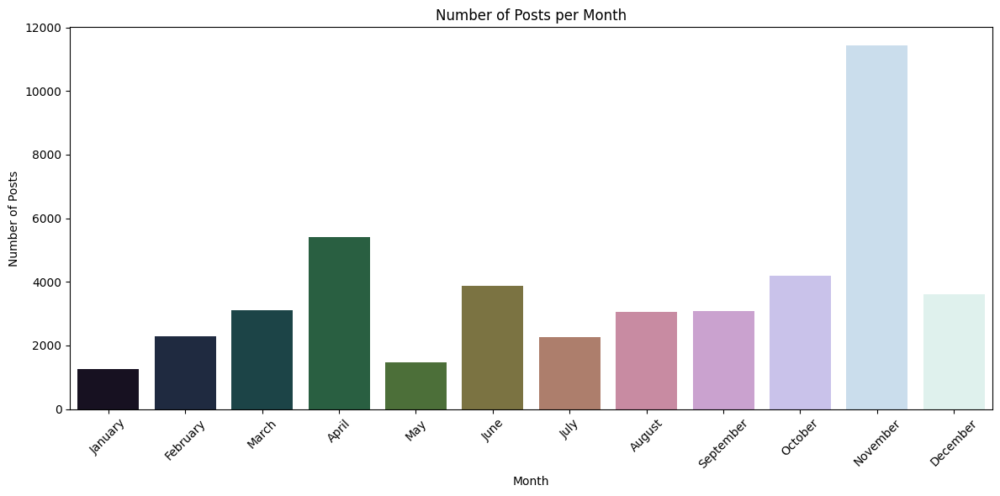

In [27]:
fig = plt.figure(figsize=(12, 6))
sns.barplot(x=month_counts.index, y=month_counts.values, palette='cubehelix')
plt.title("Number of Posts per Month")
plt.xlabel("Month")
plt.ylabel("Number of Posts")
plt.xticks(rotation=45)
plt.tight_layout()

fig.savefig(save_path)
plt.show()

# month and year stacked for the tweets

In [28]:
month_map = {1:'January', 2:'February', 3:'March', 4:'April', 5:'May', 6:'June',
             7:'July', 8:'August', 9:'September', 10:'October', 11:'November', 12:'December'}
df['month_name'] = df['month'].map(month_map)

month_order = ['January', 'February', 'March', 'April', 'May', 'June',
               'July', 'August', 'September', 'October', 'November', 'December']
df['month_name'] = pd.Categorical(df['month_name'], categories=month_order, ordered=True)

month_year_counts = df.groupby(['year', 'month_name']).size().reset_index(name='count')

C:\Users\hp\AppData\Local\Temp\ipykernel_7988\2126315560.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  month_year_counts = df.groupby(['year', 'month_name']).size().reset_index(name='count')


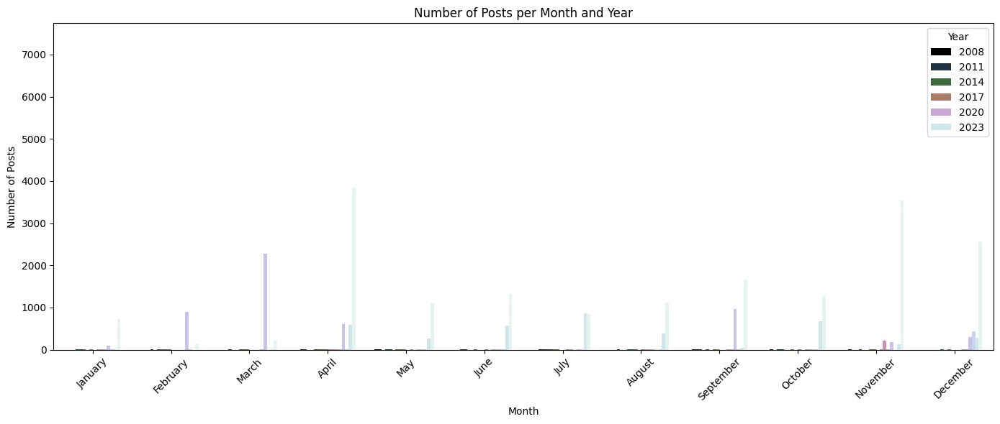

In [29]:
fig = plt.figure(figsize=(14,6))
sns.barplot(data=month_year_counts, x='month_name', y='count', hue='year', palette='cubehelix')
plt.title("Number of Posts per Month and Year")
plt.xlabel("Month")
plt.ylabel("Number of Posts")
plt.xticks(rotation=45)
plt.legend(title='Year')
plt.tight_layout()

fig.savefig(save_path)

plt.show()


# Text Analysis

In [30]:
pip install neattext

Note: you may need to restart the kernel to use updated packages.


In [31]:
import neattext.functions as nfx

In [32]:
dir(nfx)

['BTC_ADDRESS_REGEX',
 'CURRENCY_REGEX',
 'CURRENCY_SYMB_REGEX',
 'Counter',
 'DATE_REGEX',
 'EMAIL_REGEX',
 'EMOJI_REGEX',
 'HASTAG_REGEX',
 'MASTERCard_REGEX',
 'MD5_SHA_REGEX',
 'MOST_COMMON_PUNCT_REGEX',
 'NUMBERS_REGEX',
 'PHONE_REGEX',
 'PoBOX_REGEX',
 'SPECIAL_CHARACTERS_REGEX',
 'STOPWORDS',
 'STOPWORDS_de',
 'STOPWORDS_en',
 'STOPWORDS_es',
 'STOPWORDS_fr',
 'STOPWORDS_ru',
 'STOPWORDS_yo',
 'STREET_ADDRESS_REGEX',
 'TextFrame',
 'URL_PATTERN',
 'USER_HANDLES_REGEX',
 'VISACard_REGEX',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__generate_text',
 '__loader__',
 '__name__',
 '__numbers_dict',
 '__package__',
 '__spec__',
 '_lex_richness_herdan',
 '_lex_richness_maas_ttr',
 'clean_text',
 'defaultdict',
 'digit2words',
 'extract_btc_address',
 'extract_currencies',
 'extract_currency_symbols',
 'extract_dates',
 'extract_emails',
 'extract_emojis',
 'extract_hashtags',
 'extract_html_tags',
 'extract_mastercard_addr',
 'extract_md5sha',
 'extract_numbers',
 'extr

In [33]:
!pip install emoji

In [34]:
import re
import emoji

In [35]:
df['Tweet_Text']

0        The HPV vaccine is a critical step in preventi...
1        New month, new experiences, new opportunities,...
2        Blessing is protected against cervical cancer....
3                                  https://t.co/wirqlPgG1q
4        @science_nigeria @nighealthwatch @Fmohnigeria ...
5        Our CEO, Chika Offor, is joining other health ...
6        @VaccineNet_NG  Engages Gombe Stakeholders On ...
7        7m Nigerian girls vaccinated against cervical ...
8        Today is the International Day for the Elimina...
9        Happy Father's Day to all the amazing dads out...
10       #ThrowbackThursday: Last month, the VNDC team ...
11       Immunization is the best, cheapest and safest ...
12       We support Honorable Muhammad Abubakar Luggere...
13       @UcheEwelike @channelstv @docneto @Hope_Uzodim...
14       As we celebrate Democracy Day in Nigeria, let ...
15       @gavi at the 77th World Health Assembly! \n\n@...
16       Our CEO, Chika Offor adds her two pence to the.

In [36]:
df['Tweet_Text'].apply(nfx.extract_hashtags)

0        [#vaccineswork, #publichealth, #communityhealt...
1                     [#HappyNewMonth, #july, #goodhealth]
2                             [#vaccineswork, #hpvvaccine]
3                                                       []
4                                                       []
5                    [#health, #digitalhealth, #phc, #uhc]
6                                                       []
7                                                       []
8                                                       []
9                                                       []
10                                   [#ThrowbackThursday:]
11                          [#healthforall, #vaccineswork]
12                                                      []
13                                               [#wemove]
14              [#happydemocracyday, #unity, #greatnation]
15                                                      []
16       [#WHA77, #HealthForAll, #AllforHealth, #nozero.

In [37]:
df['clean_Text'] = df['Tweet_Text'].apply(nfx.remove_hashtags)

In [38]:
df[['Tweet_Text', 'clean_Text']]

,Tweet_Text,clean_Text
0,The HPV vaccine is a critical step in preventi...,The HPV vaccine is a critical step in preventi...
1,"New month, new experiences, new opportunities,...","New month, new experiences, new opportunities,..."
2,Blessing is protected against cervical cancer....,Blessing is protected against cervical cancer....
3,https://t.co/wirqlPgG1q,https://t.co/wirqlPgG1q
4,@science_nigeria @nighealthwatch @Fmohnigeria ...,@science_nigeria @nighealthwatch @Fmohnigeria ...
5,"Our CEO, Chika Offor, is joining other health ...","Our CEO, Chika Offor, is joining other health ..."
6,@VaccineNet_NG Engages Gombe Stakeholders On ...,@VaccineNet_NG Engages Gombe Stakeholders On ...
7,7m Nigerian girls vaccinated against cervical ...,7m Nigerian girls vaccinated against cervical ...
8,Today is the International Day for the Elimina...,Today is the International Day for the Elimina...
9,Happy Father's Day to all the amazing dads out...,Happy Father's Day to all the amazing dads out...


# removing and cleaning texts from emojis and the likes

In [39]:
!pip install emoji

In [40]:
def full_clean(text):
    text = emoji.replace_emoji(text, replace='')
    text = re.sub(r'@\w+', '', text)
    text = re.sub(r'http\S+|www\S+|https\S+', '', text)
    text = re.sub(r'[^A-Za-z\s]', '', text)
    text = re.sub(r'\s+', ' ', text)
    text = text.strip()
    return text

df['clean_Text'] = df['clean_Text'].astype(str).apply(full_clean)

In [41]:
df['clean_Text'].head()

0    The HPV vaccine is a critical step in preventi...
1    New month new experiences new opportunities ne...
2    Blessing is protected against cervical cancer ...
3                                                     
4                                      Congratulations
Name: clean_Text, dtype: object

In [42]:
from textblob import TextBlob

In [43]:
df.columns

Index(['Tweet_Text', 'Reply_Count', 'Retweet_Count', 'Like_Count',
       'View_Count', 'Language', 'Source', 'Username', 'Location', 'year',
       'month', 'day', 'hour', 'minute', 'weekday', 'Post_ID', 'ID_Source',
       'month_name', 'clean_Text'],
      dtype='object')

In [44]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
import torch
import torch.nn.functional as F

In [45]:
df.head(2)

,Tweet_Text,Reply_Count,Retweet_Count,Like_Count,View_Count,Language,Source,Username,Location,year,month,day,hour,minute,weekday,Post_ID,ID_Source,month_name,clean_Text
0,The HPV vaccine is a critical step in preventi...,1.0,0.0,2.0,81.0,English,Twitter,VaccineNet_NG,"Lagos, Nigeria",2024,7,1,17,58,Monday,"=""1807821100576895401""",Platform_ID,July,The HPV vaccine is a critical step in preventi...
1,"New month, new experiences, new opportunities,...",0.0,0.0,2.0,50.0,English,Twitter,VaccineNet_NG,Abuja. Nigeria.,2024,7,1,15,2,Monday,"=""1807776904805580853""",Platform_ID,July,New month new experiences new opportunities ne...


# Baseline sentiment Analysis

In [46]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification, pipeline

In [47]:
model_name = "lxyuan/distilbert-base-multilingual-cased-sentiments-student"

tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name)
sentiment_model = pipeline("sentiment-analysis", model=model, tokenizer=tokenizer)

Device set to use cpu


In [48]:
def get_sentiment(text):
    text = text[:512]

    try:
        result = sentiment_model(text)[0]
        label = result['label'].lower()

        if "positive" in label:
            return "positive", [0, 0, 1]
        if "negative" in label:
            return "negative", [1, 0, 0]
        return "neutral", [0, 1, 0]

    except:
        return "neutral", [0, 1, 0]


In [49]:
sentiment_list = []
neg_list = []
neu_list = []
pos_list = []

for t in df['clean_Text']:
    sent, scores = get_sentiment(t)
    sentiment_list.append(sent)
    neg_list.append(scores[0])
    neu_list.append(scores[1])
    pos_list.append(scores[2])

df['bert_sentiment'] = sentiment_list
df['bert_neg'] = neg_list
df['bert_neu'] = neu_list
df['bert_pos'] = pos_list


In [50]:
plot_dir = r"C:\Users\hp\Desktop\immuniwatch_plots"
os.makedirs(plot_dir, exist_ok=True)

In [51]:
df['bert_sentiment'].value_counts()

bert_sentiment
positive    25374
negative    18007
neutral      1624
Name: count, dtype: int64

In [65]:
import os

plot_dir = r"C:\Users\hp\Desktop\immuniwatch_plots"
os.makedirs(plot_dir, exist_ok=True)

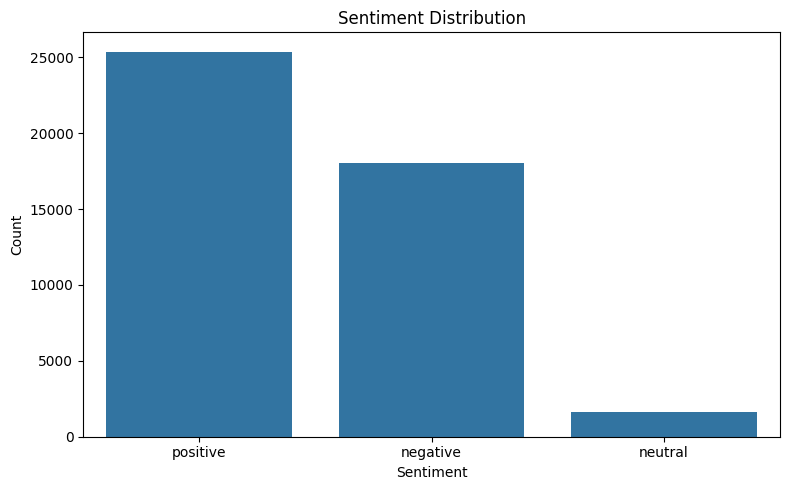

In [66]:

fig = plt.figure(figsize=(8,5))
sns.countplot(data=df, x='bert_sentiment')
plt.title("Sentiment Distribution")
plt.xlabel("Sentiment")
plt.ylabel("Count")
plt.tight_layout()

In [67]:
fig.savefig(os.path.join(plot_dir, "sentiment_distribution.png"))
plt.show()

In [68]:
pip install counter

Note: you may need to restart the kernel to use updated packages.


In [69]:
from collections import Counter

In [70]:
all_text = " ".join(df['clean_Text'].astype(str).tolist()).lower()
words = re.findall(r'\b\w+\b', all_text)
word_counts = Counter(words)
most_common_words = word_counts.most_common(100)  # top 100 words

word_dict = {word: count for word, count in most_common_words}
print(word_dict)

{'the': 25976, 'to': 15450, 'and': 14661, 'of': 11208, 'a': 11038, 'is': 10600, 'in': 9560, 'you': 8163, 'i': 7864, 'for': 7712, 'this': 6626, 'it': 6218, 'that': 6058, 'are': 5641, 'vaccine': 4821, 'they': 4392, 'not': 4227, 'with': 3938, 'be': 3848, 'we': 3815, 'my': 3755, 'have': 3690, 'was': 3677, 'on': 3520, 'all': 3292, 'vaccines': 3255, 'your': 2988, 'polio': 2954, 'so': 2950, 'no': 2870, 'people': 2802, 'from': 2702, 'will': 2466, 'as': 2461, 'but': 2435, 'what': 2359, 'its': 2264, 'or': 2187, 'by': 2173, 'can': 2161, 'one': 2033, 'health': 2018, 'at': 1991, 'who': 1962, 'get': 1907, 'do': 1883, 'just': 1849, 'if': 1841, 'about': 1830, 'had': 1814, 'dont': 1806, 'our': 1794, 'their': 1785, 'good': 1745, 'baby': 1743, 'like': 1712, 'how': 1702, 'them': 1662, 'more': 1661, 'us': 1621, 'has': 1558, 'now': 1555, 'he': 1544, 'up': 1531, 'nigeria': 1471, 'were': 1452, 'when': 1445, 'these': 1443, 'children': 1425, 'there': 1399, 'why': 1360, 'an': 1339, 'out': 1330, 'me': 1326, 'her'

In [71]:
vaccine_keywords = [
    "vaccine","vaccines","polio","covid","immunization","dose",
    "sideeffect","safety","effectiveness","risk","children","baby",
    "health","nigeria","pfizer","moderna","jab","injection"
]

all_text = " ".join(df['clean_Text'].astype(str).tolist()).lower()

words = re.findall(r'\b\w+\b', all_text)

keyword_counts = Counter(w for w in words if w in vaccine_keywords)

print(keyword_counts.most_common(50))

[('vaccine', 4821), ('vaccines', 3255), ('polio', 2954), ('health', 2018), ('baby', 1743), ('nigeria', 1471), ('children', 1425), ('covid', 1171), ('immunization', 627), ('injection', 274), ('risk', 270), ('dose', 152), ('safety', 151), ('jab', 148), ('pfizer', 116), ('effectiveness', 34), ('moderna', 20)]


# Emotion tagging

In [195]:
df['emotion_type'] = df['clean_Text'].apply(detect_emotion)

df_filtered = df[df['emotion_type'] != 'none']

emotion_counts = df_filtered['emotion_type'].value_counts()

emotion_percent = round((emotion_counts / emotion_counts.sum()) * 100, 2)

emotion_summary = pd.DataFrame({
    'Count': emotion_counts,
    'Percentage': emotion_percent
})
print(emotion_summary)

              Count  Percentage
emotion_type                   
fear             70        56.0
distrust         35        28.0
anger            12         9.6
happy             8         6.4


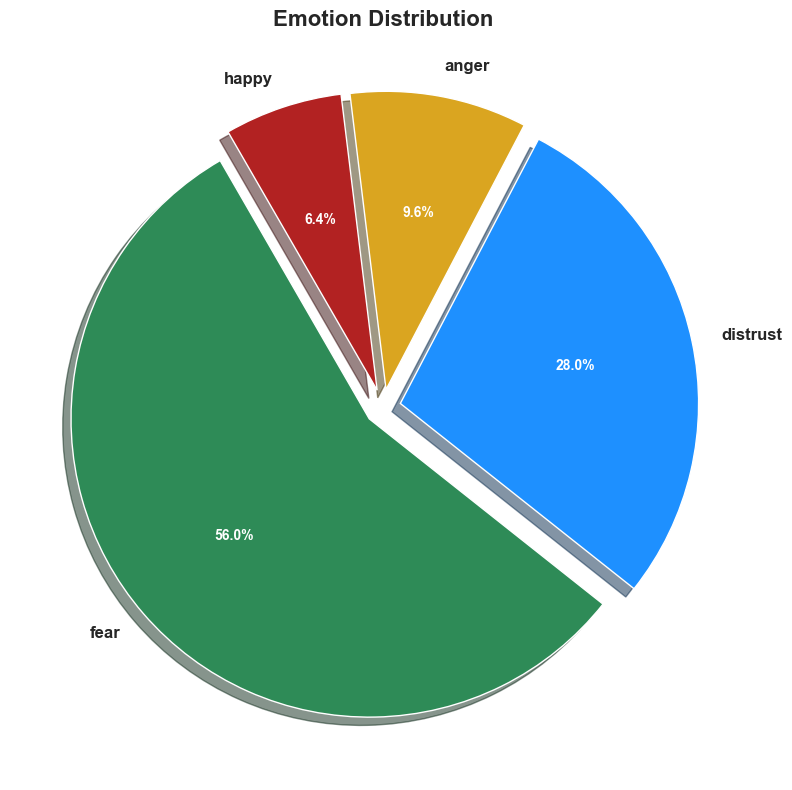

In [193]:
plot_dir = r"C:\Users\hp\Desktop\immuniwatch_plots"
os.makedirs(plot_dir, exist_ok=True)

labels = emotion_percent.index
sizes = emotion_percent.values

colors = ['#2E8B57', '#1E90FF', '#DAA520', '#B22222', '#6A5ACD', '#FF8C00', '#A0522D']
colors = colors[:len(labels)]

explode = [0.06] * len(labels)

fig, ax = plt.subplots(figsize=(10, 8))

wedges, texts, autotexts = ax.pie(
    sizes,
    labels=labels,
    autopct='%1.1f%%',
    explode=explode,
    shadow=True,
    startangle=120,
    colors=colors,
    wedgeprops={'linewidth': 1, 'edgecolor': 'white'}
)

for text in texts:
    text.set_fontsize(12)
    text.set_weight('bold')

for a in autotexts:
    a.set_color('white')
    a.set_weight('bold')

plt.title("Emotion Distribution", fontsize=16, weight='bold')
plt.tight_layout()

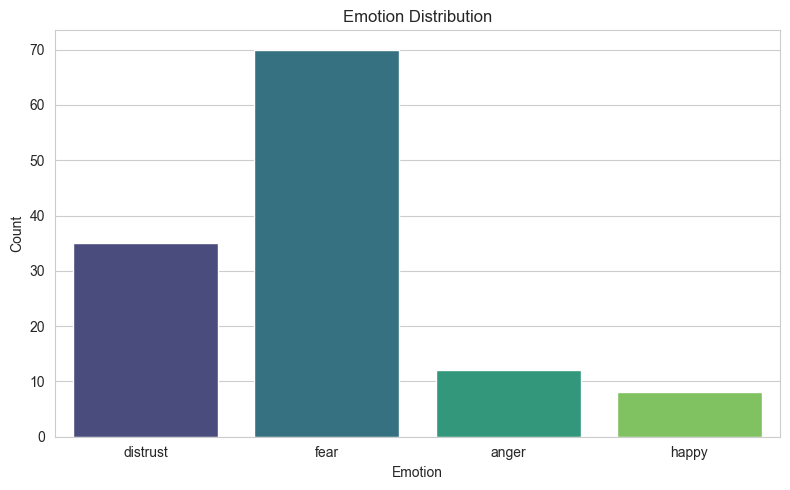

In [194]:
fig.savefig(os.path.join(plot_dir, "emotion_distribution_pie.png"))
plt.show()

plt.figure(figsize=(8,5))
sns.countplot(data=df_filtered, x='emotion_type', palette='viridis')
plt.title("Emotion Distribution")
plt.xlabel("Emotion")
plt.ylabel("Count")
plt.tight_layout()
plt.savefig(os.path.join(plot_dir, "emotion_distribution_count.png"))
plt.show()

In [85]:
def detect_emotion(text):
    t = text.lower()

    fear = [
        "fear","scared","panic","worried","afraid","terrified","danger",
        "risk","unsafe","death","harm","side effect","reaction",
        "anxiety","concern","paranoid","covid","polio",
        "dose","injection","jab","vaccine safety","effectiveness"
    ]

    anger = [
        "angry","mad","annoyed","frustrated","upset","hate",
        "disgusted","furious","rage","unfair","corrupt","forced",
        "mandate","pfizer","moderna","astrazeneca"
    ]

    distrust = [
        "fake","lie","scam","false","propaganda","doubt","never",
        "dont","hoax","conspiracy","wrong","big pharma","government lies",
        "not sure","skeptical"
    ]

    happy = [
        "happy","joy","glad","excited","delight","praise","amazing",
        "thanks","grateful","encouraged","hopeful","relief"
    ]

    if any(w in t for w in fear):
        return "fear"
    if any(w in t for w in anger):
        return "anger"
    if any(w in t for w in distrust):
        return "distrust"
    if any(w in t for w in happy):
        return "happy"
    
    return "none"

df['emotion_type'] = df['clean_Text'].apply(detect_emotion)

emotion_counts = df[df['emotion_type'] != 'none']['emotion_type'].value_counts()
emotion_percent = round((emotion_counts / emotion_counts.sum()) * 100, 2)

emotion_summary = pd.DataFrame({
    'Count': emotion_counts,
    'Percentage': emotion_percent
})

print("\nEmotion Summary:")
print(emotion_summary)


Emotion Summary:
              Count  Percentage
emotion_type                   
fear           5585       52.42
distrust       2977       27.94
anger          1177       11.05
happy           915        8.59


# locations where the emotions are coming from

In [101]:
df.columns

Index(['Tweet_Text', 'Reply_Count', 'Retweet_Count', 'Like_Count',
       'View_Count', 'Language', 'Source', 'Username', 'Location', 'year',
       'month', 'day', 'hour', 'minute', 'weekday', 'Post_ID', 'ID_Source',
       'month_name', 'clean_Text', 'bert_sentiment', 'bert_neg', 'bert_neu',
       'bert_pos', 'emotion_type'],
      dtype='object')

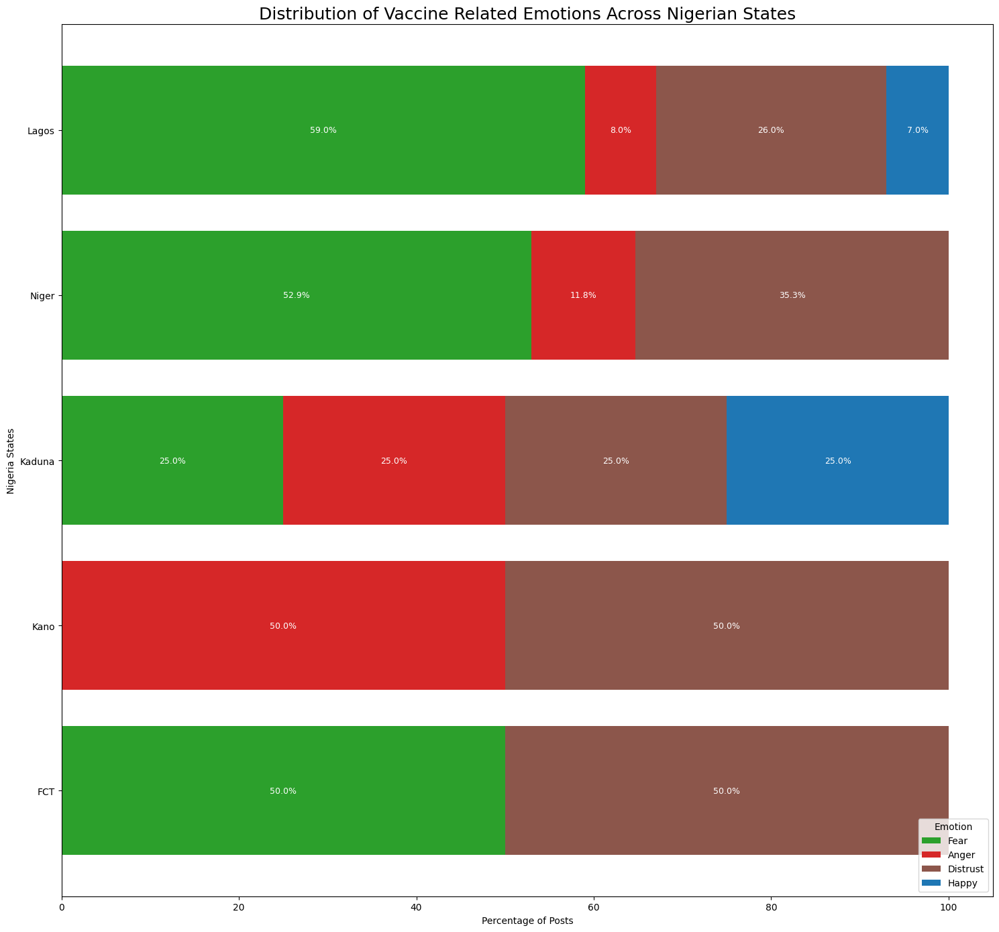

In [121]:
# List of valid Nigerian states
nigeria_states = [
    'Abia','Adamawa','Akwa Ibom','Anambra','Bauchi','Bayelsa','Benue','Borno',
    'Cross River','Delta','Ebonyi','Edo','Ekiti','Enugu','Gombe','Imo','Jigawa',
    'Kaduna','Kano','Katsina','Kebbi','Kogi','Kwara','Lagos','Nasarawa','Niger',
    'Ogun','Ondo','Osun','Oyo','Plateau','Rivers','Sokoto','Taraba','Yobe','Zamfara','FCT'
]

# Filter dataset for Nigerian states only
df_nigeria = df[df['Location'].isin(nigeria_states)].copy()

# Count posts by state and emotion
emotion_state_counts = df_nigeria.groupby(['Location', 'emotion_type']).size().unstack(fill_value=0)

for emotion in ['fear','anger','distrust','happy']:
    if emotion not in emotion_state_counts.columns:
        emotion_state_counts[emotion] = 0

emotion_state_counts['Total_Posts'] = emotion_state_counts[['fear','anger','distrust','happy']].sum(axis=1)
emotion_state_counts = emotion_state_counts[emotion_state_counts['Total_Posts'] > 0]

# Convert counts to percentages
emotion_state_pct = emotion_state_counts[['fear','anger','distrust','happy']].div(
    emotion_state_counts['Total_Posts'], axis=0
) * 100


sorted_states = emotion_state_counts.sort_values('Total_Posts', ascending=True).index


fig, ax = plt.subplots(figsize=(15, 14))

colors = ['#2ca02c', '#d62728', '#8c564b', '#1f77b4'] 

emotion_state_pct.loc[sorted_states].plot(
    kind='barh',
    stacked=True,
    color=colors,
    width=0.78,
    ax=ax
)


for i, state in enumerate(sorted_states):
    values = emotion_state_pct.loc[state]
    prev_total = 0
    for emotion, color in zip(['fear','anger','distrust','happy'], colors):
        val = values[emotion]
        if np.isfinite(val) and val > 0:
            ax.text(prev_total + val/2, i, f"{val:.1f}%", ha='center', va='center', color='white', fontsize=9)
        prev_total += val

ax.set_xlabel("Percentage of Posts")
ax.set_ylabel("Nigeria States")
ax.set_title("Distribution of Vaccine Related Emotions Across Nigerian States", fontsize=18)
ax.legend(title="Emotion", labels=['Fear','Anger','Distrust','Happy'], loc='lower right')

plt.tight_layout()

- observation
- Fear dominates in Lagos (59.0%) and Niger (52.9%), indicating safety concerns are the primary driver of vaccine hesitancy in these states. FCT shows an even split between fear (50.0%) and distrust (50.0%), suggesting mixed emotional responses in the capital. Kano presents a unique pattern with equal distribution of anger (50.0%) and distrust (50.0%), potentially reflecting historical concerns or policy-related frustrations. Kaduna demonstrates the most balanced emotion distribution with equal proportions across fear, anger, distrust, and happiness (25.0% each), suggesting diverse community perspectives that require multifaceted communication approaches.

In [122]:
#save_dir = r"C:\Users\hp\Desktop\immuniwatch_plots"  # <-- your folder
os.makedirs(save_dir, exist_ok=True)
save_path = os.path.join(save_dir, 'emotion_by_state_stacked_bar_nigeria_final_fig.png')
fig.savefig(save_path, dpi=300, bbox_inches='tight')

plt.show()


# Location Extraction

In [110]:
from geotext import GeoText

In [125]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

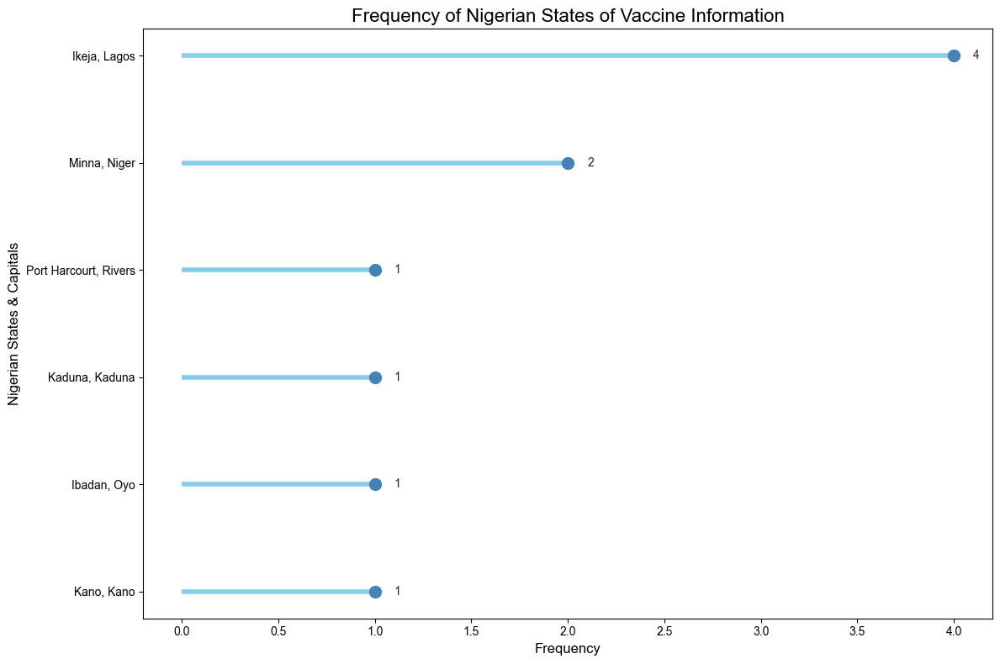

In [123]:
locations = pd.Series({
    0: 'Lagos, Nigeria', 1: 'Abuja. Nigeria.', 2: 'Lagos', 3: '', 4: 'Nigeria',
    5: 'Lagos, Nigeria.', 6: 'Global', 7: '', 8: 'odisha', 9: 'USA',
    10: 'Marina del Rey, CA', 11: 'State of Lagos, Nigeria', 12: 'Ibadan', 13: 'Kano',
    14: 'Port Harcourt', 15: 'Kaduna'
})

nigeria_states_capitals = {
    'abia': 'Umuahia, Abia', 'adamawa': 'Yola, Adamawa', 'akwa ibom': 'Uyo, Akwa Ibom',
    'anambra': 'Awka, Anambra', 'bauchi': 'Bauchi, Bauchi', 'bayelsa': 'Yenagoa, Bayelsa',
    'benue': 'Makurdi, Benue', 'borno': 'Maiduguri, Borno', 'cross river': 'Calabar, Cross River',
    'delta': 'Asaba, Delta', 'ebonyi': 'Abakaliki, Ebonyi', 'edo': 'Benin City, Edo',
    'ekiti': 'Ado-Ekiti, Ekiti', 'enugu': 'Enugu, Enugu', 'gombe': 'Gombe, Gombe',
    'imo': 'Owerri, Imo', 'jigawa': 'Dutse, Jigawa', 'kaduna': 'Kaduna, Kaduna',
    'kano': 'Kano, Kano', 'katsina': 'Katsina, Katsina', 'kebbi': 'Birnin Kebbi, Kebbi',
    'kogi': 'Lokoja, Kogi', 'kwara': 'Ilorin, Kwara', 'lagos': 'Ikeja, Lagos',
    'nasarawa': 'Lafia, Nasarawa', 'niger': 'Minna, Niger', 'ogun': 'Abeokuta, Ogun',
    'ondo': 'Akure, Ondo', 'osun': 'Osogbo, Osun', 'oyo': 'Ibadan, Oyo',
    'plateau': 'Jos, Plateau', 'rivers': 'Port Harcourt, Rivers', 'sokoto': 'Sokoto, Sokoto',
    'taraba': 'Jalingo, Taraba', 'yobe': 'Damaturu, Yobe', 'zamfara': 'Gusau, Zamfara',
    'fct': 'Abuja, FCT'
}

def clean_location(loc):
    if not isinstance(loc, str):
        return None
    loc = loc.strip().lower()
    loc = re.sub(r'\.+$', '', loc) 
    loc = re.sub(r'[^\w\s,]', '', loc)  
    
    for state, capital in nigeria_states_capitals.items():
        if state in loc or capital.split(',')[0].lower() in loc:
            return capital
    return None

# Clean locations and count occurrences
cleaned_locations = locations.apply(clean_location).dropna()
location_counts = cleaned_locations.value_counts().reset_index()
location_counts.columns = ['Location', 'Count']
location_counts = location_counts.sort_values('Count', ascending=True)

fig, ax = plt.subplots(figsize=(12, 8))
sns.set_style("whitegrid")


ax.hlines(y=location_counts['Location'], xmin=0, xmax=location_counts['Count'], color='skyblue', linewidth=4)
ax.plot(location_counts['Count'], location_counts['Location'], "o", markersize=10, color='steelblue')


for index, row in location_counts.iterrows():
    ax.text(row['Count'] + 0.1, row['Location'], str(row['Count']), va='center', fontsize=10)

ax.set_xlabel("Frequency", fontsize=12)
ax.set_ylabel("Nigerian States & Capitals", fontsize=12)
ax.set_title("Frequency of Nigerian States of Vaccine Information", fontsize=16)
plt.tight_layout()

In [126]:
#save_dir = r"C:\Users\hp\Desktop\immuniwatch_plots"
os.makedirs(save_dir, exist_ok=True)
save_path = os.path.join(save_dir, 'nigerian_states_of_vaccine_info_plot.png')
fig.savefig(save_path, dpi=300, bbox_inches='tight')

plt.show()

# locations where the sentiments are coming from

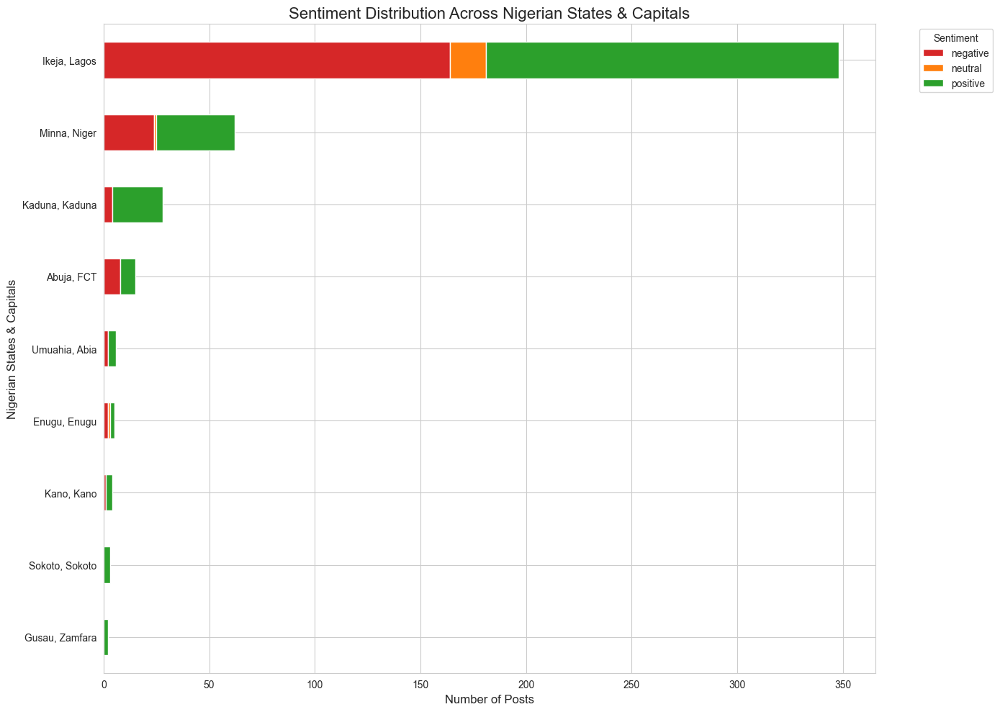

In [196]:
nigeria_states_capitals = {
    'abia': 'Umuahia, Abia', 'adamawa': 'Yola, Adamawa', 'akwa ibom': 'Uyo, Akwa Ibom',
    'anambra': 'Awka, Anambra', 'bauchi': 'Bauchi, Bauchi', 'bayelsa': 'Yenagoa, Bayelsa',
    'benue': 'Makurdi, Benue', 'borno': 'Maiduguri, Borno', 'cross river': 'Calabar, Cross River',
    'delta': 'Asaba, Delta', 'ebonyi': 'Abakaliki, Ebonyi', 'edo': 'Benin City, Edo',
    'ekiti': 'Ado-Ekiti, Ekiti', 'enugu': 'Enugu, Enugu', 'gombe': 'Gombe, Gombe',
    'imo': 'Owerri, Imo', 'jigawa': 'Dutse, Jigawa', 'kaduna': 'Kaduna, Kaduna',
    'kano': 'Kano, Kano', 'katsina': 'Katsina, Katsina', 'kebbi': 'Birnin Kebbi, Kebbi',
    'kogi': 'Lokoja, Kogi', 'kwara': 'Ilorin, Kwara', 'lagos': 'Ikeja, Lagos',
    'nasarawa': 'Lafia, Nasarawa', 'niger': 'Minna, Niger', 'ogun': 'Abeokuta, Ogun',
    'ondo': 'Akure, Ondo', 'osun': 'Osogbo, Osun', 'oyo': 'Ibadan, Oyo',
    'plateau': 'Jos, Plateau', 'rivers': 'Port Harcourt, Rivers', 'sokoto': 'Sokoto, Sokoto',
    'taraba': 'Jalingo, Taraba', 'yobe': 'Damaturu, Yobe', 'zamfara': 'Gusau, Zamfara',
    'fct': 'Abuja, FCT'
}

def map_location_to_state(loc):
    if not isinstance(loc, str):
        return None
    loc = loc.lower().strip()
    loc = re.sub(r'[^\w\s]', '', loc) 
    for state, capital_pair in nigeria_states_capitals.items():
        capital = capital_pair.split(',')[0].lower()
        if state in loc or capital in loc:
            return capital_pair
    return None

df['location_cleaned'] = df['Location'].apply(map_location_to_state)

valid_sentiments = ['positive', 'neutral', 'negative']
df_nigeria = df[df['location_cleaned'].notna() & df['bert_sentiment'].isin(valid_sentiments)].copy()

sentiment_counts = pd.pivot_table(
    df_nigeria,
    index='location_cleaned',
    columns='bert_sentiment',
    aggfunc='size',
    fill_value=0
)

for sentiment in valid_sentiments:
    if sentiment not in sentiment_counts.columns:
        sentiment_counts[sentiment] = 0

sentiment_counts['total'] = sentiment_counts.sum(axis=1)
sentiment_counts = sentiment_counts.sort_values('total', ascending=True)
sentiment_counts = sentiment_counts.drop(columns='total')

fig, ax = plt.subplots(figsize=(14, 10))
sns.set_style("whitegrid")
colors = {'positive': '#2ca02c', 'neutral': '#ff7f0e', 'negative': '#d62728'}

sentiment_counts.plot(
    kind='barh',
    stacked=True,
    color=[colors[c] for c in sentiment_counts.columns],
    ax=ax
)

ax.set_xlabel("Number of Posts", fontsize=12)
ax.set_ylabel("Nigerian States & Capitals", fontsize=12)
ax.set_title("Sentiment Distribution Across Nigerian States & Capitals", fontsize=16)
ax.legend(title="Sentiment", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

- observation
- States with Highest Negative Sentiment:
•	Ikeja, Lagos: 72.7% negative
•	Minna, Niger: Approximately 30% negative
•	Abuja, FCT: Approximately 50% negative (mixed distribution)
States with Highest Positive Sentiment:
•	Ikeja, Lagos: 27.3% positive (despite high negative sentiment)
•	Minna, Niger: 70% positive
•	Kaduna, Kaduna: Predominantly positive
The geographic analysis reveals striking disparities that challenge assumptions about vaccine hesitancy patterns and demand localized intervention strategies.
Urban Centers Show Mixed Patterns: Major urban centers demonstrate diverse sentiment patterns. Ikeja in Lagos State shows the highest concentration of posts with 72.7% negative sentiment, indicating significant vaccine hesitancy in Nigeria's commercial hub. This pattern suggests that urban populations with greater social media access are more exposed to both information and misinformation, and that higher education levels do not necessarily translate to vaccine acceptance. Urban residents may harbor greater distrust of government institutions due to accumulated experiences with governance failures, and social media echo chambers may amplify and reinforce hesitant views more effectively than in areas with less digital connectivity.


In [197]:
save_dir = r"C:\Users\hp\Desktop\immuniwatch_plots"
os.makedirs(save_dir, exist_ok=True)
save_path = os.path.join(save_dir, 'nigerian_sentiments_by_location_fig.png')
fig.savefig(save_path, dpi=300, bbox_inches='tight')

plt.show()

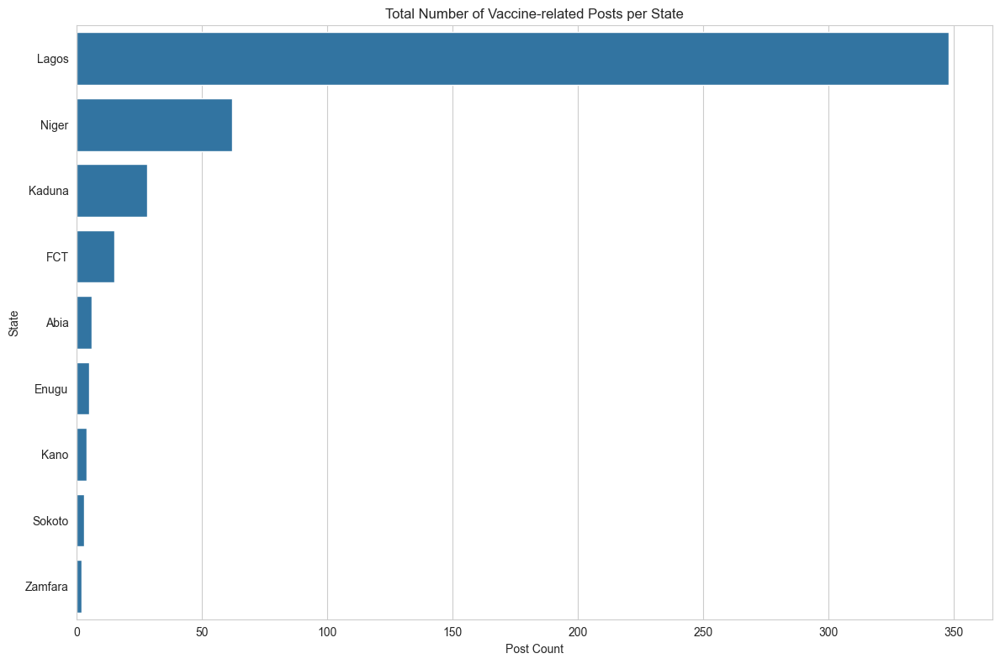

In [133]:
plt.figure(figsize=(12, 8))
sns.barplot(x=state_counts.values, y=state_counts.index, orient='h')
plt.title("Total Number of Vaccine-related Posts per State")
plt.xlabel("Post Count")
plt.ylabel("State")
plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'total_posts_states.png'), dpi=300, bbox_inches='tight')
plt.show()

<Figure size 1200x1000 with 0 Axes>

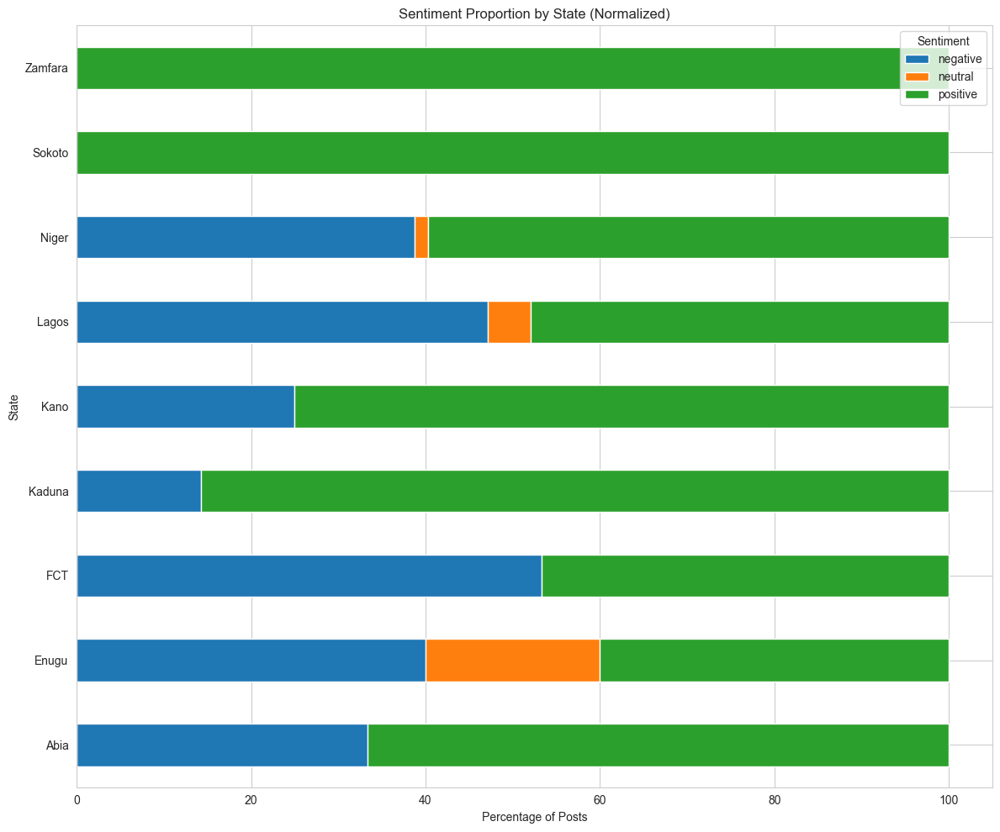

In [134]:
# getting the Sentiment proportion plot
fig = plt.figure(figsize=(12, 10))
sentiment_prop_pct.sort_index().plot(kind='barh', stacked=True, figsize=(12, 10))

plt.title("Sentiment Proportion by State (Normalized)")
plt.xlabel("Percentage of Posts")
plt.ylabel("State")
plt.legend(title="Sentiment")
plt.tight_layout()

In [135]:
fig.savefig(os.path.join(save_dir, 'sentiment_proportion_states.png'), dpi=300, bbox_inches='tight')
plt.show()

In [137]:
df2['location_state'] = df2['location_cleaned'].str.split(',').str[-1].str.strip()

# Filter valid sentiment rows
valid_sentiments = ['positive', 'neutral', 'negative']
df2 = df2[df2['bert_sentiment'].isin(valid_sentiments)]
df2 = df2[df2['location_state'].notna()]

state_counts = df2['location_state'].value_counts()

sentiment_prop = (
    df2.groupby(['location_state', 'bert_sentiment'])
       .size()
       .unstack(fill_value=0)
)

sentiment_prop_pct = sentiment_prop.div(sentiment_prop.sum(axis=1), axis=0) * 100


summary_table = sentiment_prop_pct.copy()
summary_table['Total_Posts'] = state_counts
summary_table = summary_table.sort_values('Total_Posts', ascending=False)

pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
print("\nSentiment Proportion Table (Percentages) with Total Posts:\n")
display(summary_table)



Sentiment Proportion Table (Percentages) with Total Posts:



bert_sentiment,negative,neutral,positive,Total_Posts
location_state,,,,
Lagos,47.126437,4.885057,47.988506,348
Niger,38.709677,1.612903,59.677419,62
Kaduna,14.285714,0.000000,85.714286,28
FCT,53.333333,0.000000,46.666667,15
Abia,33.333333,0.000000,66.666667,6
Enugu,40.000000,20.000000,40.000000,5
Kano,25.000000,0.000000,75.000000,4
Sokoto,0.000000,0.000000,100.000000,3
Zamfara,0.000000,0.000000,100.000000,2


In [ ]:
from bertopic import BERTopic

In [149]:
texts = df['clean_Text'].astype(str).tolist()

topic_model = BERTopic(language="english", calculate_probabilities=True)

topics, probs = topic_model.fit_transform(texts)

df['topic_id'] = topics
df['topic_probability'] = [max(p) if p is not None else None for p in probs]

topic_info = topic_model.get_topic_info()

top_n = 5
top_topics = topic_info.head(top_n)

summary_list = []

for idx, row in top_topics.iterrows():
    topic_id = row['Topic']
    size = row['Count']
    
    if topic_id == -1: 
        words = []
        example_docs = []
    else:
        words = [word for word, weight in topic_model.get_topic(topic_id)]
        example_docs = topic_model.get_representative_docs(topic_id)[:3] 
    
    summary_list.append({
        "Topic ID": topic_id,
        "Size": size,
        "Top Words": ", ".join(words[:5]),  # top 5 words
        "Example Docs": "\n---\n".join(example_docs)
    })


summary_df = pd.DataFrame(summary_list)

In [148]:
summary_df.head()

,Topic ID,Size,Top Words,Example Docs
0,-1,71,,
1,0,98,"the, vaccine, in, of, to",Btw amp the govt advised people to take the hepatitis jabs I know I had my immunisation as a child yet I took the complete jabs at the health centre in my community during Christmas FUTO included it as part of medicals for new intakes then amp I had the jabs again Hmm\n---\nI am sooo distrusting...
2,1,56,"congratulations, so, baby, beautiful, thank",Very ugly distasteful woman\n---\nVery ugly distasteful woman\n---\nVery ugly distasteful woman
3,2,33,"as, to, for, his, gmo",Bros tell them make e go round o Make our politicians no hide am like Covid palliatives o na just one shot they need and they cant use it as souvenirs for birthdays o\n---\nBros tell them make e go round o Make our politicians no hide am like Covid palliatives o na just one shot they need and th...
4,3,32,"una, dhan, mga, na, mk",Dhan Dhan Satguru Tera hi Aasra\n---\nIf you have an android phone that can browse quickly click on the link below to to jion the whatapp group called RACKSTARLIN TRADE investments it as help so many people join the link now and testify THIS LINK TO JOIN THE GROUP\n---\nIf una wnt to sell us no ...


# word cloud

In [179]:
from wordcloud import WordCloud

In [180]:
def generate_wordcloud(sentiment, color):
    text_list = df[df['bert_sentiment'] == sentiment]['clean_Text'].astype(str).tolist()
    
    if len(text_list) == 0:
        print(f"No tweets found for sentiment: {sentiment}")
        return None
    
    text = " ".join(text_list)
    wc = WordCloud(
        width=1200,
        height=600,
        background_color='white',
        color_func=lambda *args, **kwargs: color,
        max_words=200
    ).generate(text)
    
    fig, ax = plt.subplots(figsize=(14, 8))
    ax.imshow(wc, interpolation='bilinear')
    ax.axis('off')
    ax.set_title(f"Word Cloud for {sentiment.capitalize()} Tweets", fontsize=18)
    
    plt.show()
    
    return fig, sentiment

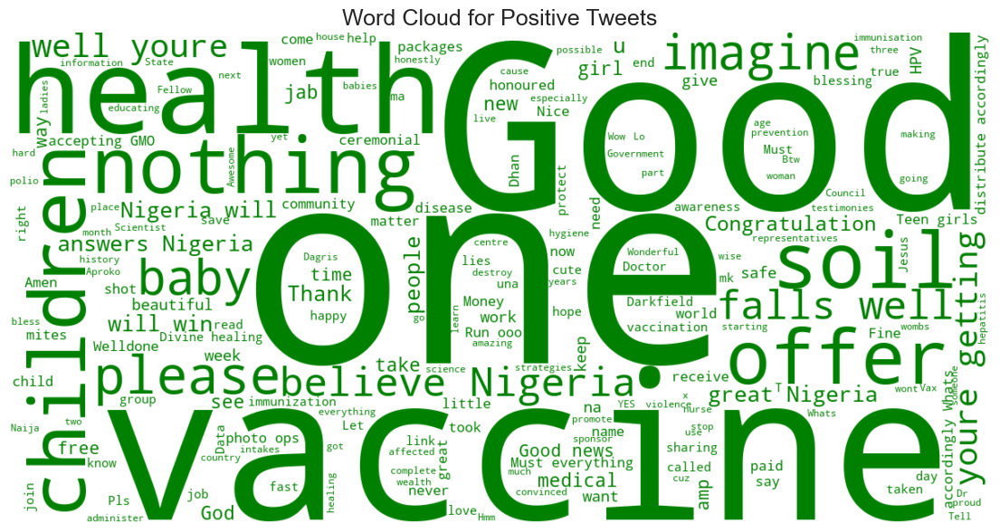

In [187]:
fig, sentiment = generate_wordcloud('positive', 'green')
if fig:
    save_path = os.path.join(save_dir, f'wordcloud_{sentiment}_fig.png')
    fig.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.close(fig)

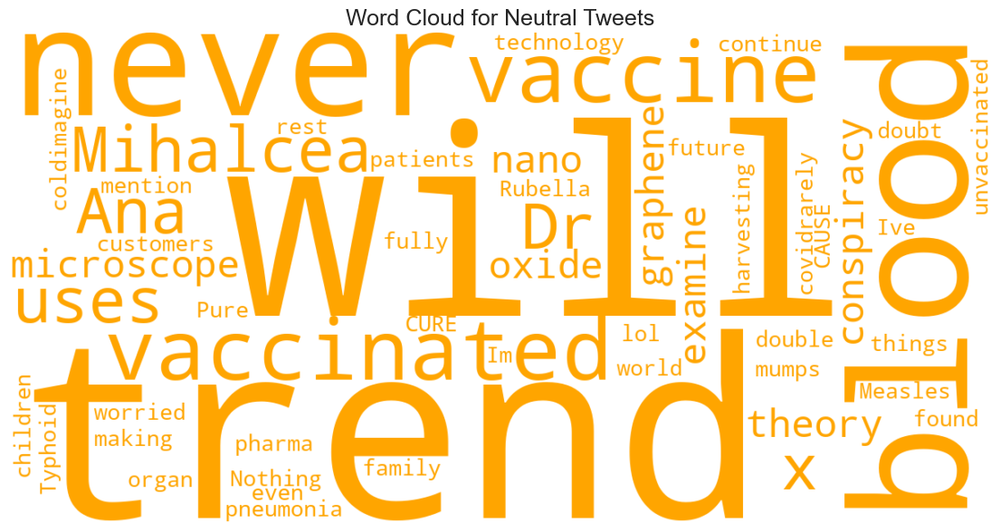

In [185]:
fig, sentiment = generate_wordcloud('neutral', 'orange')

# Save after visualizing
if fig:
    save_path = os.path.join(save_dir, f'wordcloud_{sentiment}_fig.png')
    fig.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.close(fig)

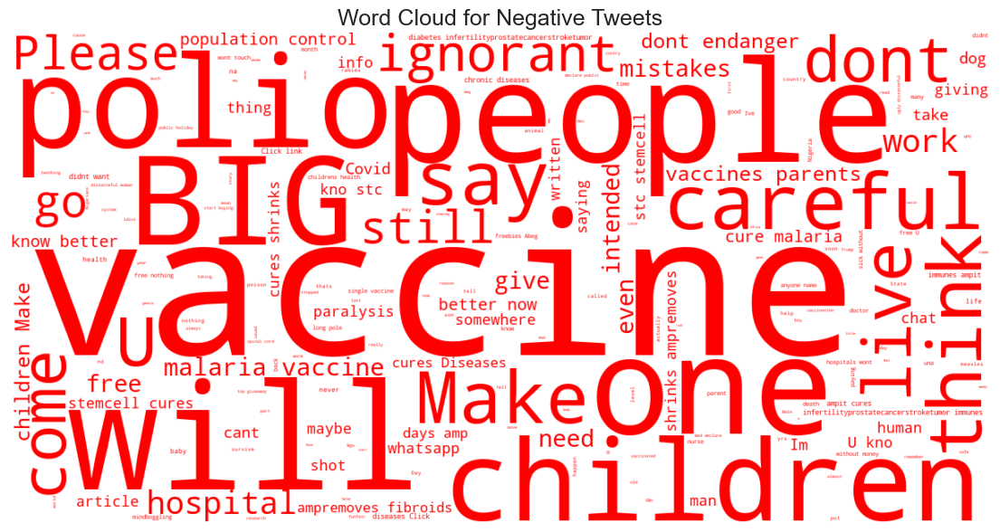

In [184]:
fig, sentiment = generate_wordcloud('negative', 'red')
if fig:
    save_path = os.path.join(save_dir, f'wordcloud_{sentiment}_fig.png')
    fig.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.close(fig)

- observations
- # Word Cloud Analysis: Key Themes by Sentiment

## Negative Sentiment Word Cloud

The word cloud for negative posts reveals dominant themes of skepticism and fear. Prominent words include **"polio," "vaccine," "careful," "ignorant,"** and **"BIG"** (likely referring to "Big Pharma"). The prevalence of **"don't"** and **"please"** suggests warnings against vaccination. Words like **"population control," "paralysis," "infertility,"** and **"endanger"** indicate common misinformation narratives linking vaccines to conspiracy theories and harmful health outcomes, demonstrating the fear-based messaging that dominates negative discourse.


## Neutral Sentiment Word Cloud

Neutral posts demonstrate a more informational tone with less emotional positioning. Dominant words include **"vaccine," "trend," "vaccinated,"** and **"never,"** suggesting factual discussions about vaccination status. Medical terminology like **"Rubella," "Measles," "pneumonia," "nano," "oxide,"** and professional references such as **"Dr.," "pharma," "patients,"** and **"technology"** reflect objective medical discourse. The appearance of **"theory," "doubt," "continue,"** and **"future"** indicates questioning and forward-looking informational content rather than strong advocacy.



## Positive Sentiment Word Cloud

Positive posts emphasize gratitude, community benefit, and faith-based support. The most prominent words are **"Good," "health," "polio," "vaccine," "baby,"** and **"God,"** reflecting celebratory vaccination experiences. Words like **"Thank," "Congratulation," "wonderful," "happy,"** and **"blessing"** express emotional satisfaction. The presence of **"Nigeria," "protect," "safe," "prevention,"** and **"offer"** demonstrates national pride and appreciation for health services. Religious language including **"God," "Divine," "Amen," "bless,"** and **"Jesus"** indicates strong faith community support for immunization programs.


In [191]:
df.head(2)

,Tweet_Text,Reply_Count,Retweet_Count,Like_Count,View_Count,Language,Source,Username,Location,year,month,day,hour,minute,weekday,Post_ID,ID_Source,month_name,clean_Text,bert_sentiment,bert_neg,bert_neu,bert_pos,emotion_type,location_cleaned,topic_id,topic_probability,topic_words,topic_prob
2,Blessing is protected against cervical cancer. \nThe HPV vaccine is available for free for girls ages 9-14 in Nigeria.\n#vaccineswork\n#hpvvaccine\n\n@gavi @NphcdaNG\n@awdf01 @AMPLIFY_Girls\n@IVACtweets @Wavaorg @Fmohnigeria https://t.co/yYGCOksrUZ,0.0,1.0,6.0,137.0,English,Twitter,VaccineNet_NG,Lagos,2024,6,27,14,27,Thursday,"=""1806318372742635560""",Platform_ID,June,Blessing is protected against cervical cancer The HPV vaccine is available for free for girls ages in Nigeria,positive,0,0,1,none,"Ikeja, Lagos",0,0.202007,"the, vaccine, of, in, to",0.216422
203,"New month, new experiences, new opportunities, new blessings\n\n#HappyNewMonth #july #goodhealth https://t.co/ow5fHs7k6K",0.0,0.0,2.0,50.0,English,Twitter,VaccineNet_NG,Lagos,2024,7,1,15,2,Monday,"=""1807776904805580853""",Platform_ID,July,New month new experiences new opportunities new blessings,positive,0,0,1,none,"Ikeja, Lagos",1,0.464323,"so, congratulations, good, thank, baby",0.732942
